In [114]:
#https://github.com/plotly/plotly.py
#https://plot.ly/python/contour-plots/
#https://plot.ly/python/3d-surface-plots/
#https://plot.ly/python-api-reference/generated/plotly.graph_objects.Figure.html
#https://plot.ly/python/builtin-colorscales/

#!pip install plotly==4.5.3

import plotly as ply
import numpy as np
import scipy as sp
from scipy import signal
import math

import plotly.graph_objects as go
import plotly.express as px

import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

%run ambiguity_function

import plotly.io as pio
pio.renderers

#Pulse train and LFM

Renderers configuration
-----------------------
    Default renderer: 'plotly_mimetype+notebook'
    Available renderers:
        ['plotly_mimetype', 'jupyterlab', 'nteract', 'vscode',
         'notebook', 'notebook_connected', 'kaggle', 'azure', 'colab',
         'cocalc', 'databricks', 'json', 'png', 'jpeg', 'jpg', 'svg',
         'pdf', 'browser', 'firefox', 'chrome', 'chromium', 'iframe',
         'iframe_connected', 'sphinx_gallery']

In [115]:
def compute_ambiguity(pulse,title,renderer='browser',colorscale = px.colors.sequential.Plasma, fig_size = 800):#browser' 
    #px.colors.sequential.Plasma
    #px.colors.sequential.thermal
    #px.colors.sequential.Jet
    #px.colors.sequential.haline
    z = ambiguity_function2(pulse,True)
    z_mag = np.absolute(z)
    sh_0, sh_1 = z_mag.shape
    #print(z_mag.shape)
    
    x, y = np.linspace(0, sh_0, sh_0), np.linspace(-1, 1, sh_1)


    fig = go.Figure(data=[go.Surface(z=z_mag,x=x,y=y,colorscale = colorscale)])

    fig.update_layout(title=title, autosize=True,
                        width=800, height=800,
                        scene = dict(
                        xaxis_title='Delay (samples)',
                        yaxis_title='Doppler (rad/pi)',
                        zaxis_title='Ambiguity'))

    fig.show(renderer=renderer,width=fig_size, height=fig_size)
    
def zadoff_chu(u,N,q=0):
    cf = N%2
    n = np.linspace(0,N-1,N);
    
    return np.exp(-1j*math.pi*u*np.multiply(n,n+cf+2*q)/N)

def barker_13(up_sample_factor):
    b13 = np.array([1, 1, 1, 1, 1, -1, -1, 1, 1, -1, 1, -1, 1])
    return b13.repeat(up_sample_factor, axis=0)

def weierstrass(M, N):
    x = np.linspace(-1,1,M)
    M = np.size(x)
    y = np.zeros((N,M))
    for n in range(1,N):
        y[n,:] = np.cos((3**n)*np.pi*x)/2**n
    return x,np.sum(y,axis=0)   

In [116]:
#Square Pulse

S_rect = np.zeros([40,])
S_rect[10:30] = 100*np.ones([20,])

compute_ambiguity(S_rect,'Time-Frequency Ambiguity (Square Pulse)')

#Barker-13

S_barker1 = barker_13(1)
compute_ambiguity(S_barker1,'Time-Frequency Ambiguity (Barker13)')

#Damped Sinusoid

t = np.linspace(0,5,150)
S_int = np.multiply(np.exp(-t),np.cos(2*math.pi*t))
S_damped_wave = np.append(S_int[::-1],S_int)

compute_ambiguity(S_damped_wave,'Time-Frequency Ambiguity (Damped Sinusoid)')

#Barker13 at 20 Sa/Sym

S_barker2 = barker_13(20)
compute_ambiguity(S_barker2,'Time-Frequency Ambiguity (Barker13 at 20 Sa/Sym)')

#Additive White Gaussian Noise

S_noise = np.random.normal(0, 10, 200)
compute_ambiguity(S_noise,'Time-Frequency Ambiguity (AWGN)')

#Zadoff-Chu

X_7 = zadoff_chu(7,353)
compute_ambiguity(X_7,'Time-Frequency Ambiguity (zadoff_chu(7,353))')



Text(0.5, 1.0, 'Abs{zadoff_chu(7,353)}')

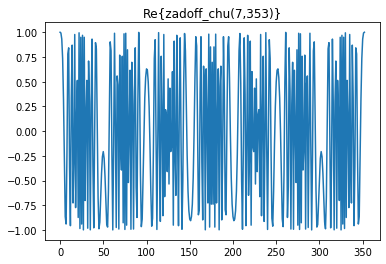

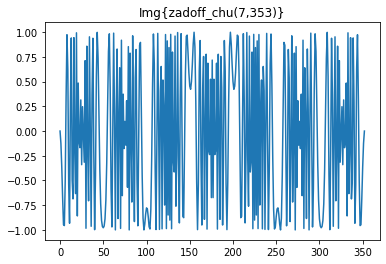

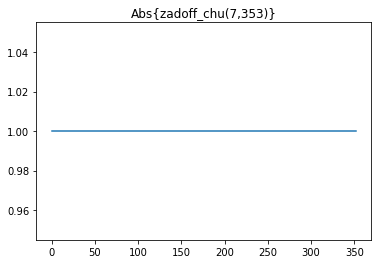

In [58]:
plt.plot(np.real(X_7))
plt.title('Re{zadoff_chu(7,353)}')
plt.figure()
plt.plot(np.imag(X_7))
plt.title('Img{zadoff_chu(7,353)}')
plt.figure()
plt.plot(np.absolute(X_7))
plt.title('Abs{zadoff_chu(7,353)}')

Text(0.5, 1.0, 'Gaussian Pulse')

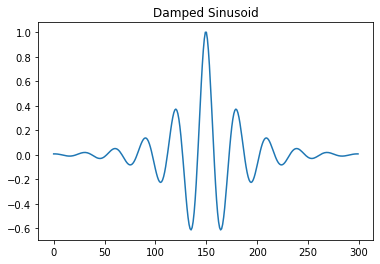

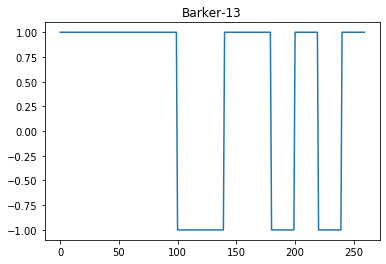

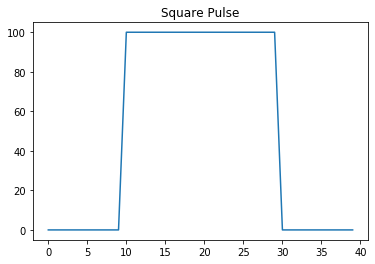

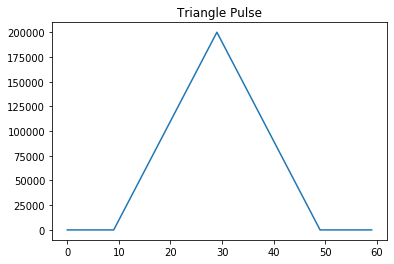

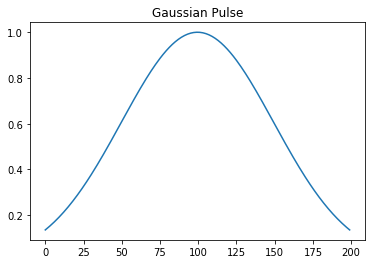

In [117]:
plt.plot(S_damped_wave)
plt.title('Damped Sinusoid')
plt.figure()
plt.plot(S_barker2)
plt.title('Barker-13')
plt.figure()
plt.plot(S_rect)
plt.title('Square Pulse')
plt.figure()
plt.plot(S_tri[10:70])
plt.title('Triangle Pulse')
plt.figure()
plt.plot(S_gauss)
plt.title('Gaussian Pulse')


In [42]:
t = np.linspace(0,5,150)
S_int = np.multiply(np.exp(-t),np.cos(2*math.pi*t))
S_int = np.multiply(S_int,np.sin(2*math.pi*t))
S_int = np.multiply(S_int,np.cos(2*math.pi*t))

S_damped_wave = np.append(S_int[::-1],S_int)

compute_ambiguity(S_damped_wave,'Time-Frequency Ambiguity (Novelty Pulse)')

(300, 300)


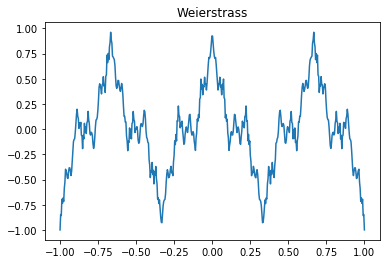

(500, 500)


In [47]:
x,y = weierstrass(500, 500)

plt.plot(x,y)
plt.title('Weierstrass')
plt.show()

compute_ambiguity(y,'Time-Frequency Ambiguity (Weierstrass)')

In [44]:
t = np.linspace(0,5,150)
S_int = np.multiply(np.exp(-t),np.cos(2*math.pi*t))
S_int = np.multiply(S_int,np.sin(2*math.pi*t))
S_int = np.multiply(S_int,np.cos(2*math.pi*t))
S_int = np.multiply(S_int,np.sin(2*math.pi*t))
S_int = np.multiply(S_int,np.cos(2*math.pi*t))

S_damped_wave = np.append(S_int[::-1],S_int)

compute_ambiguity(S_damped_wave,'Time-Frequency Ambiguity (Novelty Pulse)')

(300, 300)


In [48]:
S_tri = np.convolve(S_rect,S_rect)
compute_ambiguity(S_tri[10:70],'Time-Frequency Ambiguity (Triangle Pulse)')

(60, 60)


In [49]:
t = np.linspace(-2,2,200)
S_gauss = np.exp(-t**2/2)

compute_ambiguity(S_gauss,'Time-Frequency Ambiguity (Gaussian Pulse)')

(200, 200)
